
### Bearbeitet von: 
##### Duc Tung, Bui (s0575652) 
##### Thao Ngan, Nguyen (s0575566) 
##### Thanh Ngan, Pham (s0573773)

# Der Rössler Attraktor


Der **Rössler Attraktor** gehört zu den **seltsamen Attraktoren** und ist ein System aus drei nichtlineraren Differentialgleichungen. <br> 
Dieses System wurde erstmals in den 1970er Jahren von Otto Rössler untersucht.

$\dot{X} = -(Y+Z)$ <br>
$\dot{Y} = X + aY$ <br>
$\dot{Z} = b + (X-c) Z$

Diese Differentialgleichungen definieren ein kontinuierliches zeitdynamisches System, das die chaotische Dynamik zeigt. <br>
Die Umlaufbahn innerhalb des Attraktors folgt einer nach außen gerichteten Spirale in der Nähe der x-, y-Ebene um den instabilen **Fixpunkt**. <br>

Sobald sich der Graph weit genug nach außen dreht, wirkt ein zweiter **Fixpunkt** auf den Graphen aus und verursacht einen z-Dimensionalen Anstieg und eine Drehung. <br>

Der **Rössler Attraktor** leitet sich aus den **Lorenz-Attraktor** und ähnelt es vom Verhalten her. Bei diesem System ging es um die Modellierung von Zuständen in der Erdatmosphäre. Ein bekanntes Phenomen ist der **Butterflyeffekt**. Der **Butterflyeffekt** ist eng verwandt mit dem **Lorenz-Attraktor**, welches veranschaulichen soll, dass im atmosphärischen Strömungsbild kleine Ursachen große Wirkung zeigen können.

https://www.dynamicmath.xyz/strange-attractors/?fbclid=IwAR3BA7BeBYMQt7X2O1Rud05wcFOoVaxbGTdpklfve2US3_uEGYaCq-bb5uM

In diesem Projekt werden wir den Rössler Attraktor numerisch mit der **Runge-Kutta-Methode 4. Ordnung** sowie **8. Ordnung** analysieren. Des Weiteren erstellen wir eine drei dimensionalem Animation und schauen uns an wie sich die Lösung in Abhängigkeit von **c** verhält.

**Runge-Kutta-Verfahren** sind Verfahren zur näherungsweisen Lösung von Anfangswertproblemen in der numerischen Mathematik. 

In [1]:
import numpy as np
import scipy.integrate
from scipy.integrate import odeint, solve_ivp
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation

### Runge-Kutta-Verfahren 4.Ordung

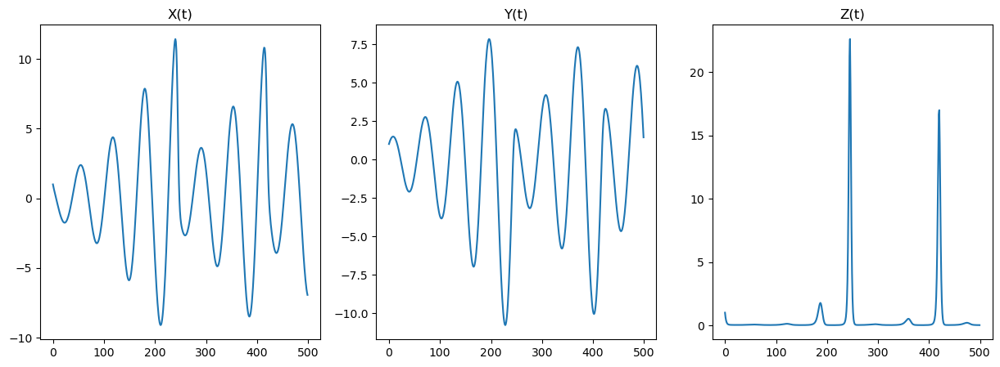

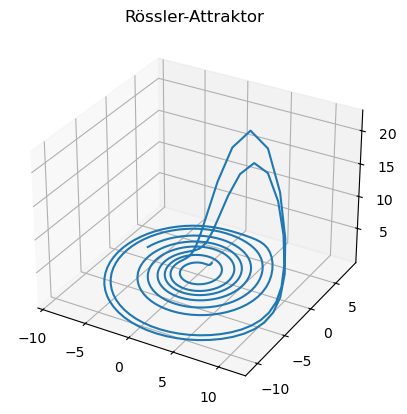

In [2]:
# Konstante Parameter a, b,c ,t, t_end
a = 0.2  
b = 0.2
c = 5.7

# Startwert, Endwert & Schrittweite festlegen
t = 0
t_end = 50 ## 50 ##100
h = 0.1  ## 0.1 ##0.01


# Rössler Attraktor als Funktion definieren
# Die Funktion beschreibt die zeitliche Änderung von x,y,z
def roessler(t, new_point):
    #  new_point ist array von neuen Punkten, die durch die Schrittweite erzeugt wird
    x = new_point[0] 
    y = new_point[1]
    z = new_point[2]
    
    # die Formel von Roessler Atraktor
    dx_dt = -y - z  
    dy_dt = x + a * y
    dz_dt = b + z * (x - c)
    return np.array([dx_dt, dy_dt, dz_dt])

# leere Array von x,y,z, time erzeugen
time = np.empty([0])
x = np.empty([0])
y = np.empty([0])
z = np.empty([0])

# Anfangswert von new_point festlegen
new_point = np.array([1.0, 1.0, 1.0])

# Runge-Kutta Methode 4. Ordnung
# RK4 nimmt einen Durchschnitt von 4 Schätzungen der Ableitung an einem Punkt, um die neue Position nach einem Zeitschritt zu berechnen
# Das Verfahren läuft von Anfangswert t bis Endwert t_end
while t <= t_end:
        
        time = np.append(time, t)
        
        # neue new_point in x,y,z wird durch "append" zugeordnet, nachdem die RK4-Formel ausgeführt wurde. 
        z = np.append(z, new_point[2])
        y = np.append(y, new_point[1])
        x = np.append(x, new_point[0])
        
        # Formel der Runge-Kutta-Verfahren 4.Ordnung
        k1 = roessler(t, new_point)
        k2 = roessler(t+h/2, new_point+h*k1/2)
        k3 = roessler(t+h/2, new_point+h*k2/2)
        k4 = roessler(t+h, new_point+h*k3)
        
        # new_point berechnen
        new_point = new_point +(h/6)*(k1+2*k2+2*k3+k4)
        
        # t steigt mit der Schrittweite "h" bis zu t_end durch die Schleife
        t = t + h 
        
        # nummerische Lösung ausgeben
        # print("Time:", t, "New_point:", new_point)


# Erstellen des Plots (leer) 
fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize = (15, 5))

# Achsenbereiche setzen und beschriften
# Einzelne Achsen als Funktion von t plotten
# Die Grafiken beschreiben die Änderung von x,y,z mit der Zeit "t"
ax1.plot(x)
ax1.set_title("X(t)") 
ax2.plot(y)
ax2.set_title("Y(t)")
ax3.plot(z)
ax3.set_title("Z(t)")

# 3D Plot erstellen 
fig1=plt.figure()
ax4 = fig1.add_subplot(projection = "3d", title ="Rössler-Attraktor")
ax4.plot(x,y,z)

# Bild anzeigen
plt.show()

Man sieht eine chaotische Bewegung. Man kann nicht vorhesagen, wann die Partikeln in die Z-Ebene osziliert und wie lange die Partikeln in der XY-Ebene bleibt.


### Runge-Kutta-Verfahren 8.Ordung mit scipy.integrate.solve_ivp

In [3]:
# Die Funktion "variiert" verändert die Konstante "c" und die Anfangswerte "y0"  
def variiert(c, y0):  
    # Die Funktion "roessler" erzeugen mit den Parametern t, neue_punkte, a, b, & c
    def roessler(t, neue_punkte , a, b,c):
        
        x, y, z = neue_punkte
        
        # Roessler Formel
        dx = -y - z
        dy = x + a * y
        dz = b + z * (x - c)
     
        return [dx, dy, dz]
    
    # Feste Parameter a, b
    a = 0.2
    b = 0.2

    # Parameters des Systems
    p = (a, b, c)  

 
    # Zeitinterval t_span mit Schrittweite 0.01
    t_span = (0.0, 50)  # Bei stören von c beträgt der t_span (0.0, 200)
    t = np.arange(0.0, 50, 0.1) # Bei stören von c beträgt der t_span (0.0, 200, 0.01)

    # Lösung des Verfahren mit scipy.integrate.solve_ivp mit der Methode der 8.Ordnung des Runge-Kutta-Verfahrens "DOP853"
    result_solve_ivp = solve_ivp(roessler, t_span, y0, args=p, method = 'DOP853', t_eval=t)
    lv = scipy.integrate.solve_ivp(roessler, t_span , y0, args = p, method='DOP853', t_eval=t)
    
    # Das Ergebnis lv ausgegeben
    print(lv)
    
    # Leere Plot erstellen
    fig = plt.figure()
    
    # Achsen beschriften und die Werte von x,y,z in Plot einfügen
    ax = fig.add_subplot(111 , projection='3d')
    ax.plot(result_solve_ivp.y[0, :],
        result_solve_ivp.y[1, :],
        result_solve_ivp.y[2, :])
    ax.set_title("solve_ivp")

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.000e+00  8.139e-01 ... -6.764e+00 -6.944e+00]
            [ 1.000e+00  1.112e+00 ...  2.111e+00  1.461e+00]
            [ 1.000e+00  6.349e-01 ...  1.634e-02  1.602e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1577
     njev: 0
      nlu: 0


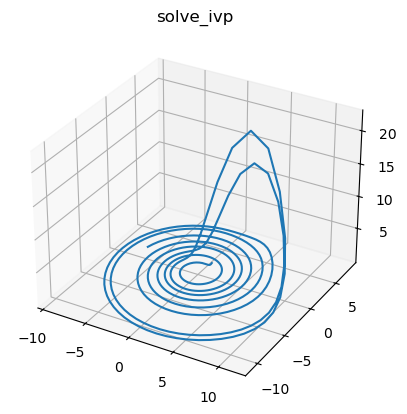

In [4]:
variiert(5.7,  y0 = [1.0, 1.0, 1.0])

### Animation

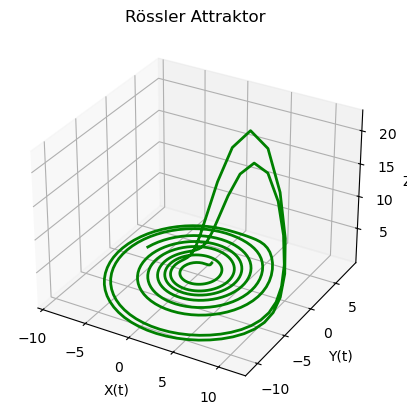

In [5]:
# Animation von Matplotlib erstellen als Funktion
# Übergebe den Plot die Funktion "func" die es zeichnet 
def func(num, point, line):
    line.set_data(point[0:2, :num])    
    line.set_3d_properties(point[2, :num])    
    return line


# Array von Punkten in 3D (x,y,z) 
point = np.array([x,y,z])


# 3D Plot erstellen
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d') 
#linien aus Punkten erstellen
line = plt.plot(point[0], point[1], point[2], lw=2, c='g')[0] # Für line plot
 
#Achsen beschriften
ax.set_xlabel('X(t)')
ax.set_ylabel('Y(t)')
ax.set_zlabel('Z(t)')
ax.set_title('Rössler Attraktor')
 
# Plot mit "animation.FuncAnmation" darstellen
# len(time) als frames angeben, 
# fargs sind Tupel die die an jedem Aufruf von "func" ubergeben werden muss
# Zeitinterval stellt die Abstande von Millisekunden zwischen den frames dar
# blit Standardwert ist False
line_ani = animation.FuncAnimation(fig, func, frames=len(time), fargs=(point,line), interval=50, blit=False)
 
 
plt.show()

In [6]:
# Animation erstellen
from IPython.display import HTML
HTML(line_ani.to_jshtml())

Animation size has reached 20987154 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### Betrachte c an den Grezen von [2,7]

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.000e+00  7.985e-01 ... -4.069e-01 -5.551e-02]
            [ 1.000e+00  1.111e+00 ... -3.529e+00 -3.624e+00]
            [ 1.000e+00  9.147e-01 ...  6.216e-02  6.771e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1151
     njev: 0
      nlu: 0


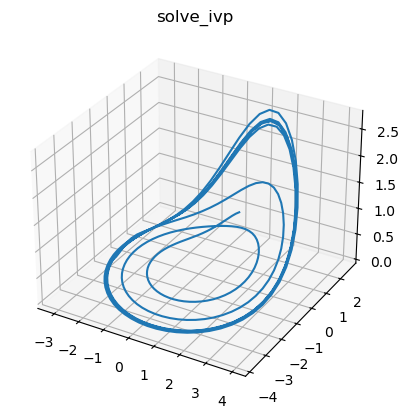

In [7]:
variiert(2,  y0 = [1.0,1.0,1.0])   

Wir betrachten c in den Grezen von [2,7] mit den Startwerten vom (1.0, 1.0, 1.0). Je kleiner wir c wahlen desto schlechter erkennen wir die Form des Rössler Attraktor. Der Wert c sollte im Opimalfall in der nähe vom Basiswert gleich 5.7 liegen 


  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.000e+00  8.185e-01 ... -5.720e+00 -6.221e+00]
            [ 1.000e+00  1.112e+00 ...  5.232e+00  4.735e+00]
            [ 1.000e+00  5.587e-01 ...  1.652e-02  1.567e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1859
     njev: 0
      nlu: 0


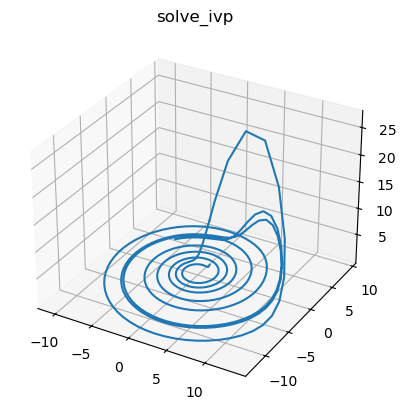

In [8]:
variiert(7,  y0 = [1.0,1.0,1.0])

### Anfangswert x(0) = 1.01 für c = 3.3 stören


  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.010e+00  8.142e-01 ... -5.010e+00 -4.833e+00]
            [ 1.000e+00  1.112e+00 ... -1.527e+00 -2.055e+00]
            [ 1.000e+00  8.053e-01 ...  2.377e-02  2.409e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1430
     njev: 0
      nlu: 0


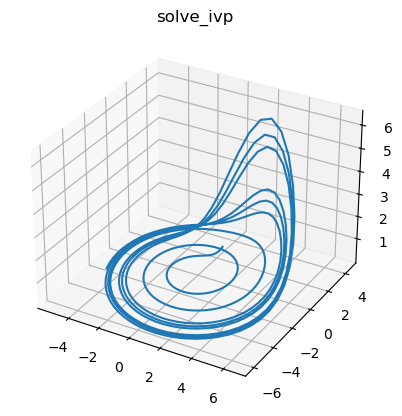

In [9]:
variiert(3.3,  y0 = [1.01,1.0,1.0])

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.000e+00  8.043e-01 ... -5.000e+00 -4.824e+00]
            [ 1.000e+00  1.111e+00 ... -1.518e+00 -2.045e+00]
            [ 1.000e+00  8.045e-01 ...  2.380e-02  2.412e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1430
     njev: 0
      nlu: 0


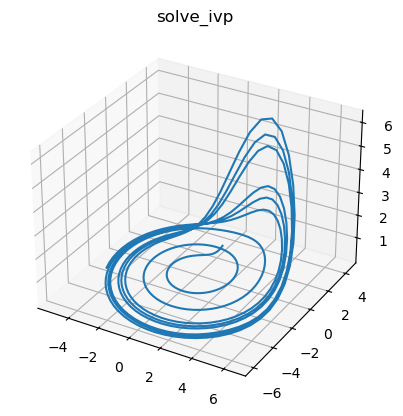

In [10]:
variiert(3.3,  y0 = [1.0,1.0,1.0])

Bei c = 3.3 mit gestörtem Anfangswert x(0) = 1.01 und nicht gestörtem Anfangswert x(0) = 1.0 sehen wir kaum Änderung

### Anfangswert x(0) = 1.01 für c = 6.3 stören

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.000e+00  8.160e-01 ... -7.000e+00 -7.333e+00]
            [ 1.000e+00  1.112e+00 ...  3.635e+00  2.984e+00]
            [ 1.000e+00  5.985e-01 ...  1.543e-02  1.497e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1748
     njev: 0
      nlu: 0


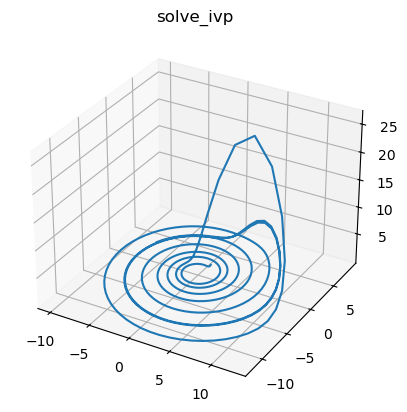

In [11]:
variiert(6.3,  y0 = [1.0,1.0,1.0])

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-01 ...  4.980e+01  4.990e+01]
        y: [[ 1.010e+00  8.259e-01 ... -6.580e+00 -6.838e+00]
            [ 1.000e+00  1.113e+00 ...  2.878e+00  2.258e+00]
            [ 1.000e+00  5.991e-01 ...  1.587e-02  1.548e-02]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1889
     njev: 0
      nlu: 0


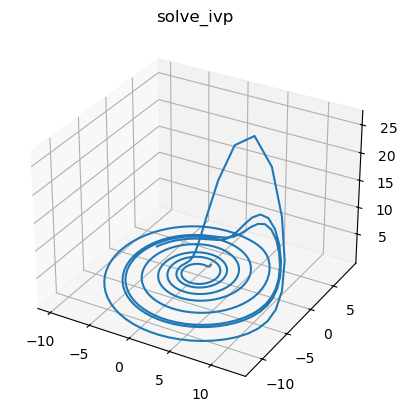

In [12]:
variiert(6.3,  y0 = [1.01,1.0,1.0])

Bei gestörten Anfangswerten mit c = 6.3 sehen wir eine deutliche Änderung. Bei veränderten Anfangswert x0 = 1.01 sehem wir wenig periodisches Verhalten als bei x0 = 1.0.

### Zusammenfassung

Der **Rössler Attraktor** ist im Allgemein ein seltsamer Attraktor und resultiert aus dem **Lorenz Attraktor**. Seltsamer Attraktoren werden im Grunde verwendet, um einen Attraktor zu beschreiben, der eine Abhängigkeit von den Anfangsbedingungen aufweist (d.h. Punkte, die anfangs auf dem Attraktor nahe beieinander liegen, werden mit der Zeit exponentiell voneinander getrennt). Wir haben die numerische Lösung der **Rössler Attraktor** mit der **Runge Kutta Verfahren 4. Ordnung** und **8. Ordnung** gelöst. Allerdings gibt es noch andere Verfahren um die numerische Lösung zu lösen, wie z.B. das **Euler Verfahren** oder die **Runge Kutta Verfahren 5. Ordnung**. <br>

Nach dem wir den **Rössler Attraktor** geplotet haben und uns jeweils die unterschiedlichen Startwerte und den Parameter **c** angeschaut haben können wir sagen, dass der bei **kleine Störung der Anfangswerten** sich auch das periodische Verhalten des **Flugbahnes** verändert.  <br>
Wenn man die konstanten Parameter a, b, c oder die Anfangswerte x(0), y(0), z(0) verändert, dann verändert sich die Flugbahn der Partikeln. Die konstanten Parameter a, b, c sollen optimal im Bereich von Rössler liegen (a = 0.2, a = 0.2, c = 5.7). Wir erhalten die sogenannte **Rössler's Form** für diese Werte. Andernfalls hätten wir keine **Rössler's Form**. 